# Problem Statement: 

    Over the years, the company has collected basic bank details and gathered a lot of credit-related information. The management wants to build an intelligent system to segregate the people into credit score brackets to reduce the manual efforts.
    
    
    You are working as a data scientist in a global finance company. Over the years, the company has collected basic bank details and gathered a lot of credit-related information. The management wants to build an intelligent system to segregate the people into credit score brackets to reduce the manual efforts.
    
# TASK:
    Given a person’s credit-related information, build a machine learning model that can classify the credit score.

# Data Description

1. Data has 2 Files Train Data and Test Data. Train data has 28 Columns and Test data has 27 Columns
2. Columns:-

    1. **ID**: Represents a unique identification of an entry
    2. **Customer ID**: Represents a unique identification of a person
    3. **Month**: Represents the month of the year
    4. **Age:** Represents the age of the person
    5. **SSN:** Represents the social security number of a person
    6. **Occupation**: Represents the occupation of the person
    7. **Annual_Income:** Represents the annual income of the person
    8. **Monthly_Inhand_Salary** Represents the monthly base salary of a person
    9. **Num_Bank_Accounts:** Represents the number of bank accounts a person holds
    10. **Num_Credit_Card:** Represents the number of other credit cards held by a person
    11. **Interest_Rate:** Represents the interest rate on credit card
    12. **Num_of_Loan:** Represents the number of loans taken from the bank
    13. **Type_of_Loan:** Represents the types of loan taken by a person
    14. **Delay_from_due_date:** Represents the average number of days delayed from the payment date
    15. **Num_of_Delayed_Payment:** Represents the average number of payments delayed by a person
    16. **Changed_Credit_Limit:** Represents the percentage change in credit card limit
    17. **Num_Credit_Inquiries:** Represents the number of credit card inquiries
    18. **Credit_Mix:** Represents the classification of the mix of credits
    19. **Outstanding_Debt:** Represents the remaining debt to be paid (in USD)
    20. **Credit_Utilization_Ratio:** Represents the utilization ratio of credit card
    21. **Credit_History_Age:** Represents the age of credit history of the person
    22. **Payment_of_Min_Amount:** Represents whether only the minimum amount was paid by the person
    23. **Total_EMI_per_month:** Represents the Equated Monthly Installments payments (in USD)
    24. **Amount_invested_monthly:** Represents the monthly amount invested by the customer (in USD)
    25. **Payment_Behaviour:** Represents the payment behavior of the customer (in USD)
    26. **Monthly_Balance:** Represents the monthly balance amount of the customer (in USD)
    27. **Credit_Score:** Represents the bracket of credit score (Poor, Standard, Good)

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [76]:
import warnings
import pandas as pd
import numpy as np
import plotly.express as px
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn import preprocessing
from sklearn.impute import KNNImputer
from keras.regularizers import l2
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn import metrics
from sklearn .metrics import accuracy_score
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [2]:
# reading train and test data set
train = pd.read_csv("train.csv")


C:\Users\Sumeet Maheshwari\AppData\Local\Temp\ipykernel_22676\3584533929.py:2: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  train = pd.read_csv("train.csv")


In [3]:
test = pd.read_csv("test.csv")

In [4]:
train.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [5]:
test.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24_,821-00-0265,Scientist,19114.12,NaN,3,...,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.986667,2,...,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


In [6]:
# shape of train and test
print(f"Total no of rows in train_df:{train.shape[0]} and columns in train_df {train.shape[1]}")
# shape of train and test
print(f"Total no of rows in test_df:{test.shape[0]} and columns in test_df {test.shape[1]}")

Total no of rows in train_df:100000 and columns in train_df 28
Total no of rows in test_df:50000 and columns in test_df 27


In [7]:
#basic information
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [8]:
# test dataset basic info
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ID                        50000 non-null  object 
 1   Customer_ID               50000 non-null  object 
 2   Month                     50000 non-null  object 
 3   Name                      44985 non-null  object 
 4   Age                       50000 non-null  object 
 5   SSN                       50000 non-null  object 
 6   Occupation                50000 non-null  object 
 7   Annual_Income             50000 non-null  object 
 8   Monthly_Inhand_Salary     42502 non-null  float64
 9   Num_Bank_Accounts         50000 non-null  int64  
 10  Num_Credit_Card           50000 non-null  int64  
 11  Interest_Rate             50000 non-null  int64  
 12  Num_of_Loan               50000 non-null  object 
 13  Type_of_Loan              44296 non-null  object 
 14  Delay_

In [9]:
# checking null values:
train.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              1200
Credit_Score                    0
dtype: int64

In [10]:
# checking null values in %age:
train.isnull().mean()*100

ID                           0.000
Customer_ID                  0.000
Month                        0.000
Name                         9.985
Age                          0.000
SSN                          0.000
Occupation                   0.000
Annual_Income                0.000
Monthly_Inhand_Salary       15.002
Num_Bank_Accounts            0.000
Num_Credit_Card              0.000
Interest_Rate                0.000
Num_of_Loan                  0.000
Type_of_Loan                11.408
Delay_from_due_date          0.000
Num_of_Delayed_Payment       7.002
Changed_Credit_Limit         0.000
Num_Credit_Inquiries         1.965
Credit_Mix                   0.000
Outstanding_Debt             0.000
Credit_Utilization_Ratio     0.000
Credit_History_Age           9.030
Payment_of_Min_Amount        0.000
Total_EMI_per_month          0.000
Amount_invested_monthly      4.479
Payment_Behaviour            0.000
Monthly_Balance              1.200
Credit_Score                 0.000
dtype: float64

In [11]:
def plot_nas(df: pd.DataFrame):
    if df.isnull().sum().sum() != 0:
        na_df = (df.isnull().sum() / len(df)) * 100      
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({'Missing Ratio %' :na_df})
        missing_data.plot(kind = "barh")
        plt.figure(figsize=(10,6))
        plt.show()
        
    else:
        print('No NAs found')

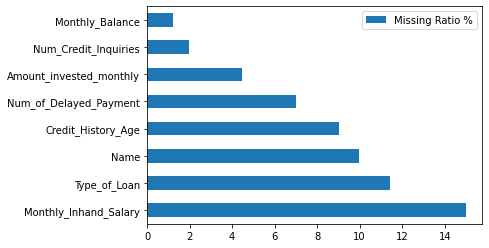

<Figure size 720x432 with 0 Axes>

In [12]:
plot_nas(train)

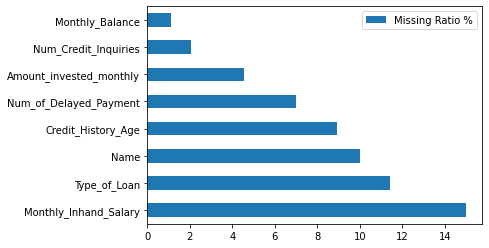

<Figure size 720x432 with 0 Axes>

In [13]:
plot_nas(test)

<AxesSubplot:>

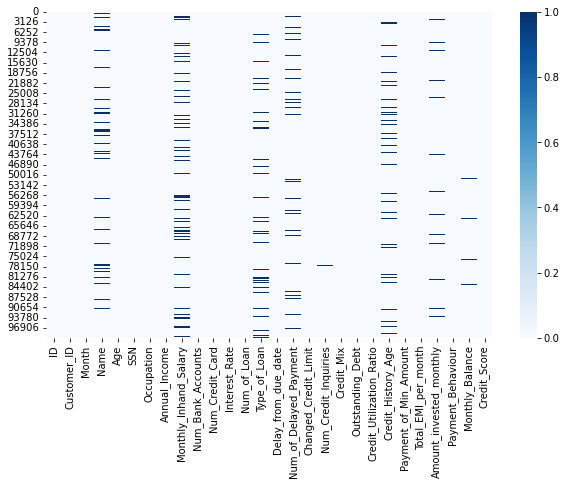

In [14]:
plt.figure(figsize=(10,6))
sns.heatmap(train.isna(), cmap="Blues")

<AxesSubplot:>

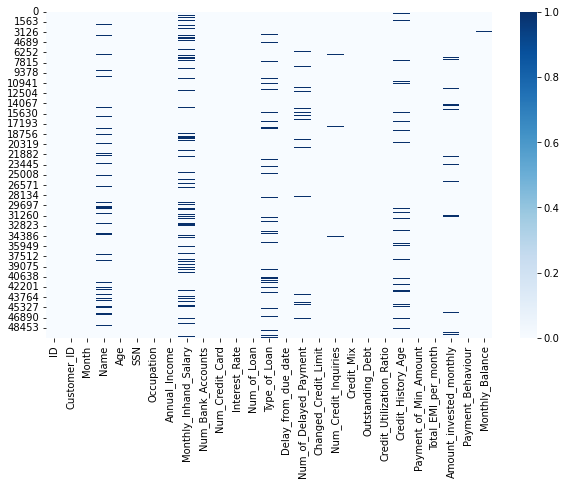

In [15]:
plt.figure(figsize=(10,6))
sns.heatmap(test.isna(), cmap="Blues")

In [16]:
# basic describtion
train.describe().T

,count,mean,std,min,25%,50%,75%,max
Monthly_Inhand_Salary,84998.0,4194.170850,3183.686167,303.645417,1625.568229,3093.745000,5957.448333,15204.633333
Num_Bank_Accounts,100000.0,17.091280,117.404834,-1.000000,3.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,100000.0,22.474430,129.057410,0.000000,4.000000,5.000000,7.000000,1499.000000
Interest_Rate,100000.0,72.466040,466.422621,1.000000,8.000000,13.000000,20.000000,5797.000000
Delay_from_due_date,100000.0,21.068780,14.860104,-5.000000,10.000000,18.000000,28.000000,67.000000
Num_Credit_Inquiries,98035.0,27.754251,193.177339,0.000000,3.000000,6.000000,9.000000,2597.000000
Credit_Utilization_Ratio,100000.0,32.285173,5.116875,20.000000,28.052567,32.305784,36.496663,50.000000
Total_EMI_per_month,100000.0,1403.118217,8306.041270,0.000000,30.306660,69.249473,161.224249,82331.000000


In [17]:
# basic describition using object:
train.describe(include="object").T

,count,unique,top,freq
ID,100000,100000,0x1602,1
Customer_ID,100000,12500,CUS_0xd40,8
Month,100000,8,January,12500
Name,90015,10139,Langep,44
Age,100000,1788,38,2833
SSN,100000,12501,#F%$D@*&8,5572
Occupation,100000,16,_______,7062
Annual_Income,100000,18940,36585.12,16
Num_of_Loan,100000,434,3,14386
Type_of_Loan,88592,6260,Not Specified,1408


In [18]:
# basic describtion
test.describe().T

,count,mean,std,min,25%,50%,75%,max
Monthly_Inhand_Salary,42502.0,4182.004291,3174.109304,303.645417,1625.188333,3086.305000,5934.189094,15204.633333
Num_Bank_Accounts,50000.0,16.838260,116.396848,-1.000000,3.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,50000.0,22.921480,129.314804,0.000000,4.000000,5.000000,7.000000,1499.000000
Interest_Rate,50000.0,68.772640,451.602363,1.000000,8.000000,13.000000,20.000000,5799.000000
Delay_from_due_date,50000.0,21.052640,14.860397,-5.000000,10.000000,18.000000,28.000000,67.000000
Num_Credit_Inquiries,48965.0,30.080200,196.984121,0.000000,4.000000,7.000000,10.000000,2593.000000
Credit_Utilization_Ratio,50000.0,32.279581,5.106238,20.509652,28.061040,32.280390,36.468591,48.540663
Total_EMI_per_month,50000.0,1491.304305,8595.647887,0.000000,32.222388,74.733349,176.157491,82398.000000


In [19]:
# basic describition using object:
train.describe(include="object").T

,count,unique,top,freq
ID,100000,100000,0x1602,1
Customer_ID,100000,12500,CUS_0xd40,8
Month,100000,8,January,12500
Name,90015,10139,Langep,44
Age,100000,1788,38,2833
SSN,100000,12501,#F%$D@*&8,5572
Occupation,100000,16,_______,7062
Annual_Income,100000,18940,36585.12,16
Num_of_Loan,100000,434,3,14386
Type_of_Loan,88592,6260,Not Specified,1408


In [20]:
train.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

In [21]:
cat_cols = train.select_dtypes(include=['object']).columns

In [22]:
cat_cols

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Num_of_Loan', 'Type_of_Loan',
       'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Credit_Mix',
       'Outstanding_Debt', 'Credit_History_Age', 'Payment_of_Min_Amount',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

In [23]:
train.nunique()

ID                          100000
Customer_ID                  12500
Month                            8
Name                         10139
Age                           1788
SSN                          12501
Occupation                      16
Annual_Income                18940
Monthly_Inhand_Salary        13235
Num_Bank_Accounts              943
Num_Credit_Card               1179
Interest_Rate                 1750
Num_of_Loan                    434
Type_of_Loan                  6260
Delay_from_due_date             73
Num_of_Delayed_Payment         749
Changed_Credit_Limit          4384
Num_Credit_Inquiries          1223
Credit_Mix                       4
Outstanding_Debt             13178
Credit_Utilization_Ratio    100000
Credit_History_Age             404
Payment_of_Min_Amount            3
Total_EMI_per_month          14950
Amount_invested_monthly      91049
Payment_Behaviour                7
Monthly_Balance              98792
Credit_Score                     3
dtype: int64

In [24]:
test.nunique()

ID                          50000
Customer_ID                 12500
Month                           4
Name                        10139
Age                           976
SSN                         12501
Occupation                     16
Annual_Income               16121
Monthly_Inhand_Salary       12793
Num_Bank_Accounts             540
Num_Credit_Card               819
Interest_Rate                 945
Num_of_Loan                   263
Type_of_Loan                 6260
Delay_from_due_date            73
Num_of_Delayed_Payment        443
Changed_Credit_Limit         3927
Num_Credit_Inquiries          750
Credit_Mix                      4
Outstanding_Debt            12685
Credit_Utilization_Ratio    50000
Credit_History_Age            399
Payment_of_Min_Amount           3
Total_EMI_per_month         13144
Amount_invested_monthly     45450
Payment_Behaviour               7
Monthly_Balance             49433
dtype: int64

Text(0.5, 1.0, 'Target feature distribution in Train data')

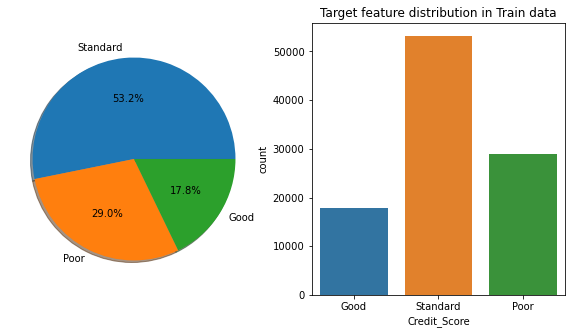

In [25]:
#Distribution of data in target feature

plt.figure(figsize=(10,5))

#plot pie chart
plt.subplot(1,2,1)
label = train.Credit_Score.value_counts().index
label_count = train.Credit_Score.value_counts().values
plt.pie(data=train, x=label_count, labels=label, autopct='%1.1f%%', shadow=True, radius=1)

#
plt.subplot(1,2,2)
sns.countplot(x='Credit_Score', data=train)
plt.title('Target feature distribution in Train data')

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Customer Monthly Salary Distribution')

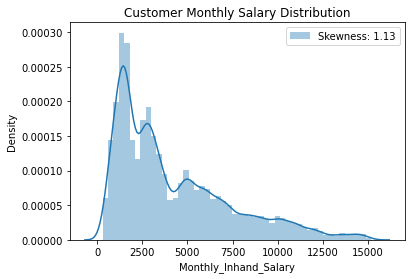

In [26]:
### Understanding the distribution of the column - Monthly_Inhand_Salary

sns.distplot(train['Monthly_Inhand_Salary'], label = 'Skewness: %.2f'%(train['Monthly_Inhand_Salary'].skew()))
plt.legend(loc = 'best')
plt.title('Customer Monthly Salary Distribution')

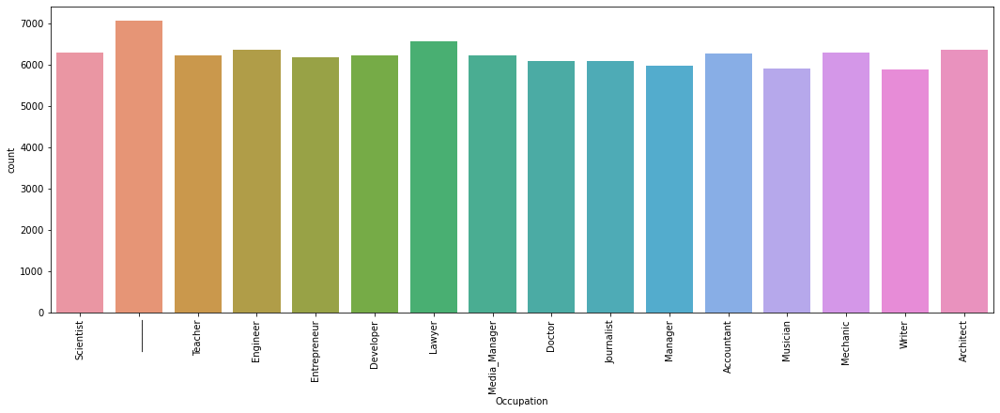

In [27]:
# count plot for Occupaction
plt.figure(figsize=(18,6))
sns.countplot(data=train, x = "Occupation")
plt.xticks(rotation=90)
plt.show()

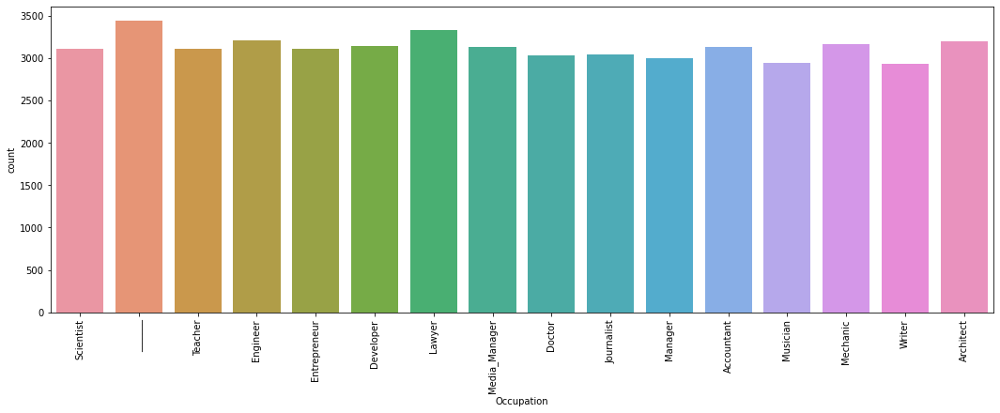

In [28]:
# count plot for Occupaction
plt.figure(figsize=(18,6))
sns.countplot(data=test, x = "Occupation")
plt.xticks(rotation=90)
plt.show()

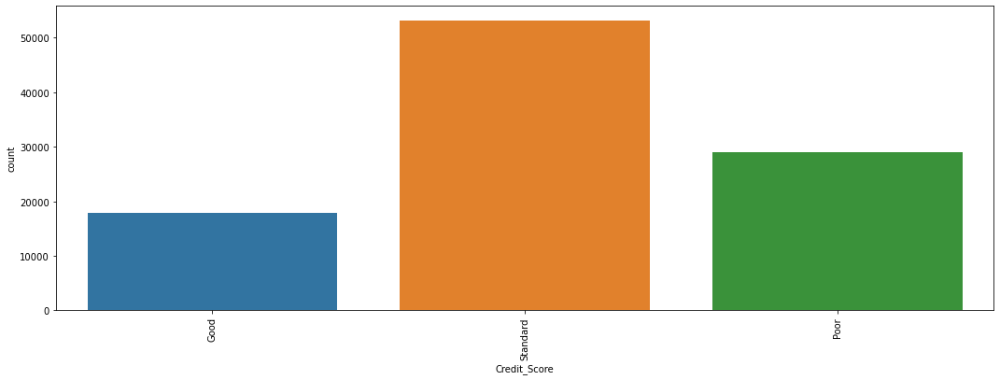

In [29]:
# count plot for Occupaction
plt.figure(figsize=(18,6))
sns.countplot(data=train, x = "Credit_Score")
plt.xticks(rotation=90)
plt.show()

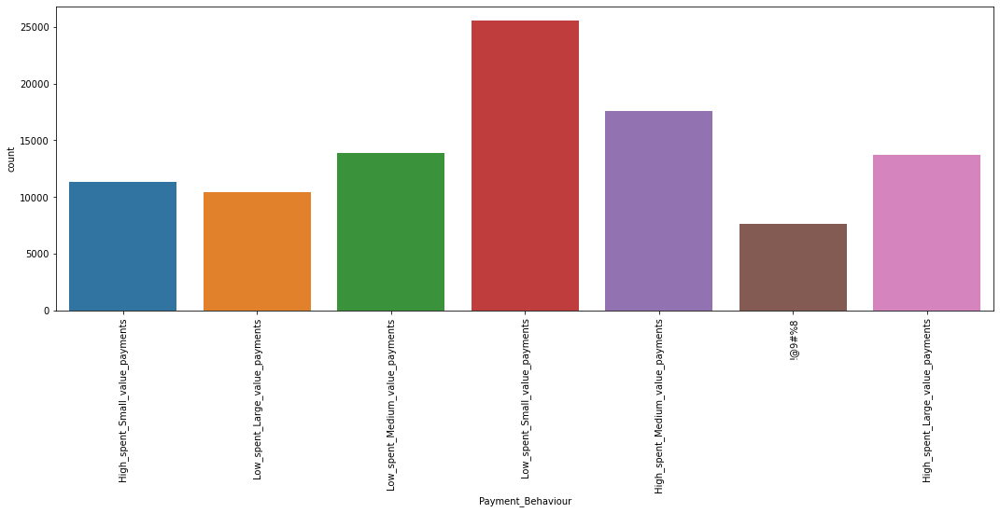

In [30]:

# count plot for Occupaction
plt.figure(figsize=(18,6))
sns.countplot(data=train, x = "Payment_Behaviour")
plt.xticks(rotation=90)
plt.show()

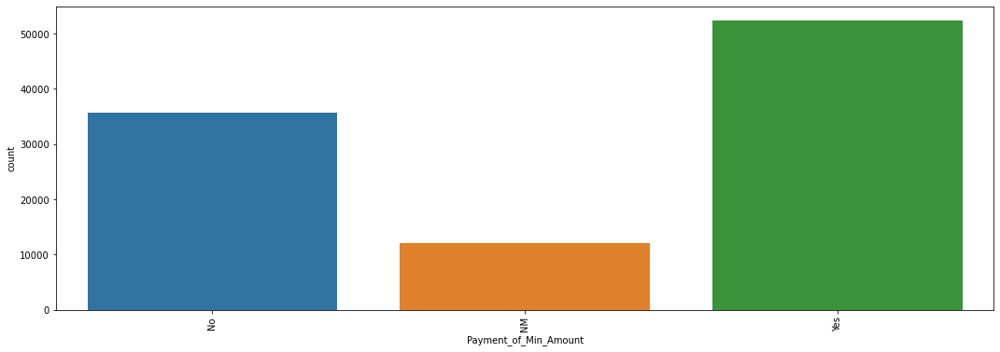

In [31]:

# count plot for Occupaction
plt.figure(figsize=(18,6))
sns.countplot(data=train, x = "Payment_of_Min_Amount")
plt.xticks(rotation=90)
plt.show()

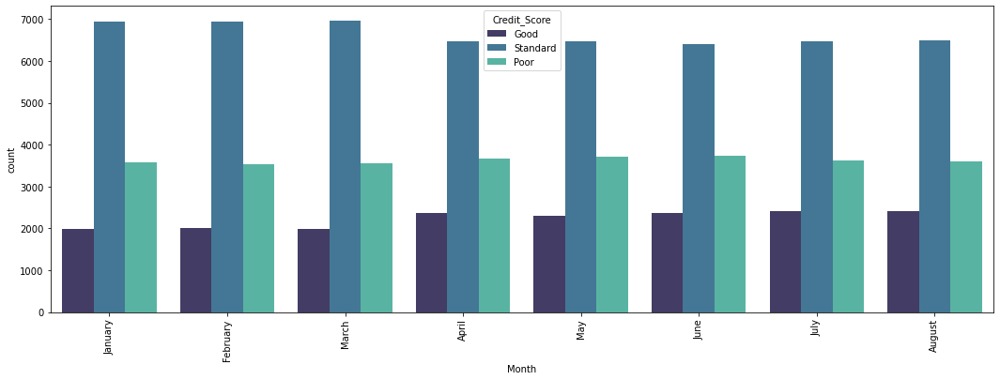

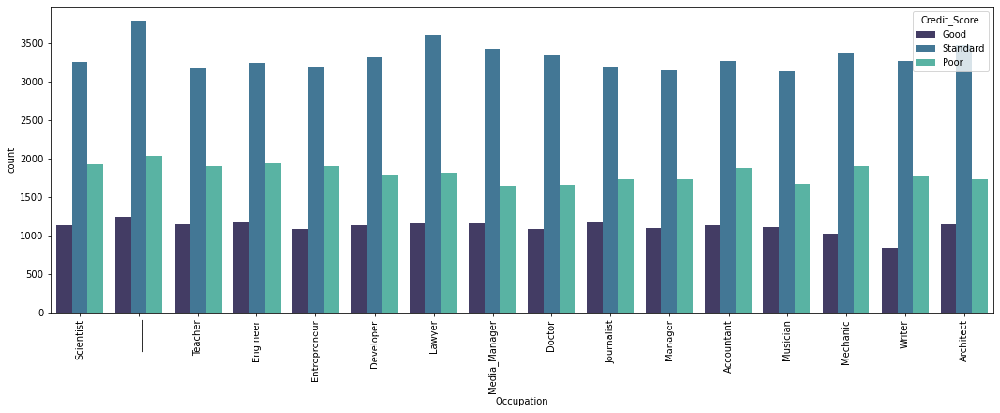

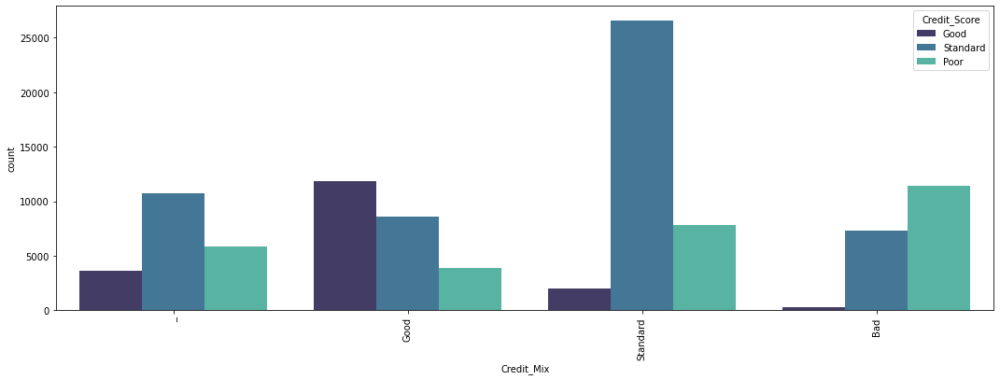

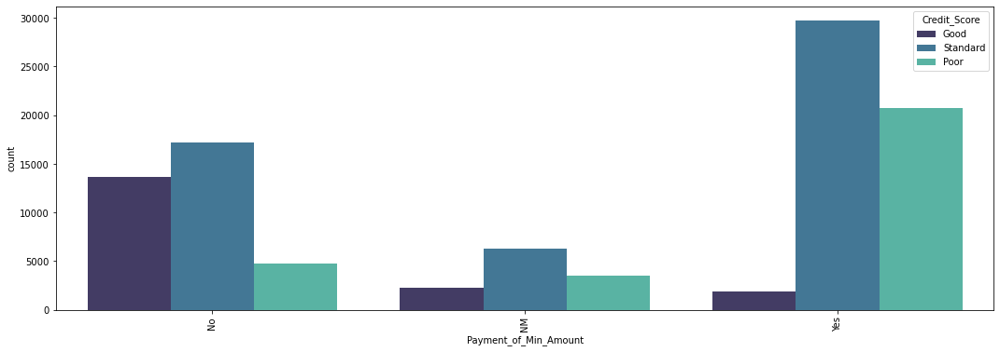

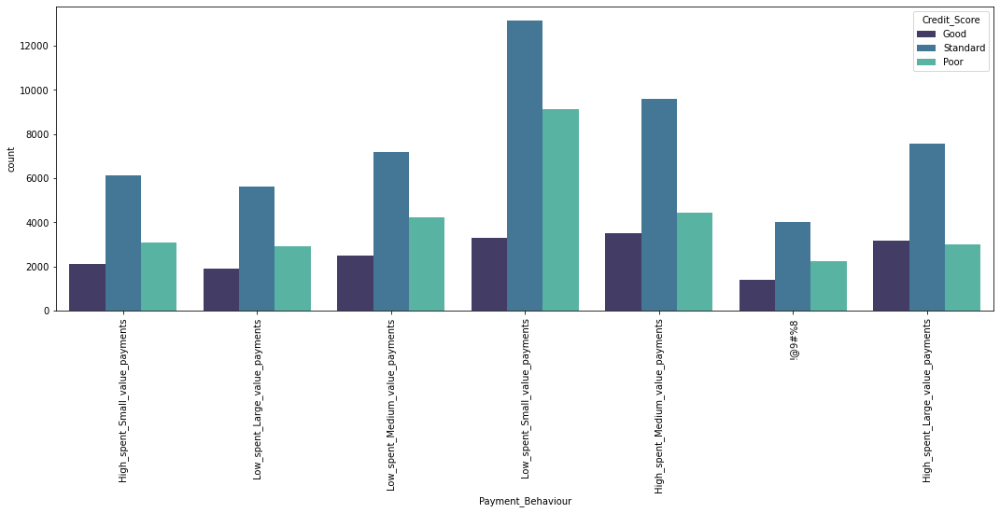

In [32]:
for col in ['Month', 'Occupation', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour']:
        plt.figure(figsize=(18,6))
        sns.countplot(x=col,data=train, palette="mako", hue="Credit_Score")
        plt.xticks(rotation=90)
        plt.show()

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


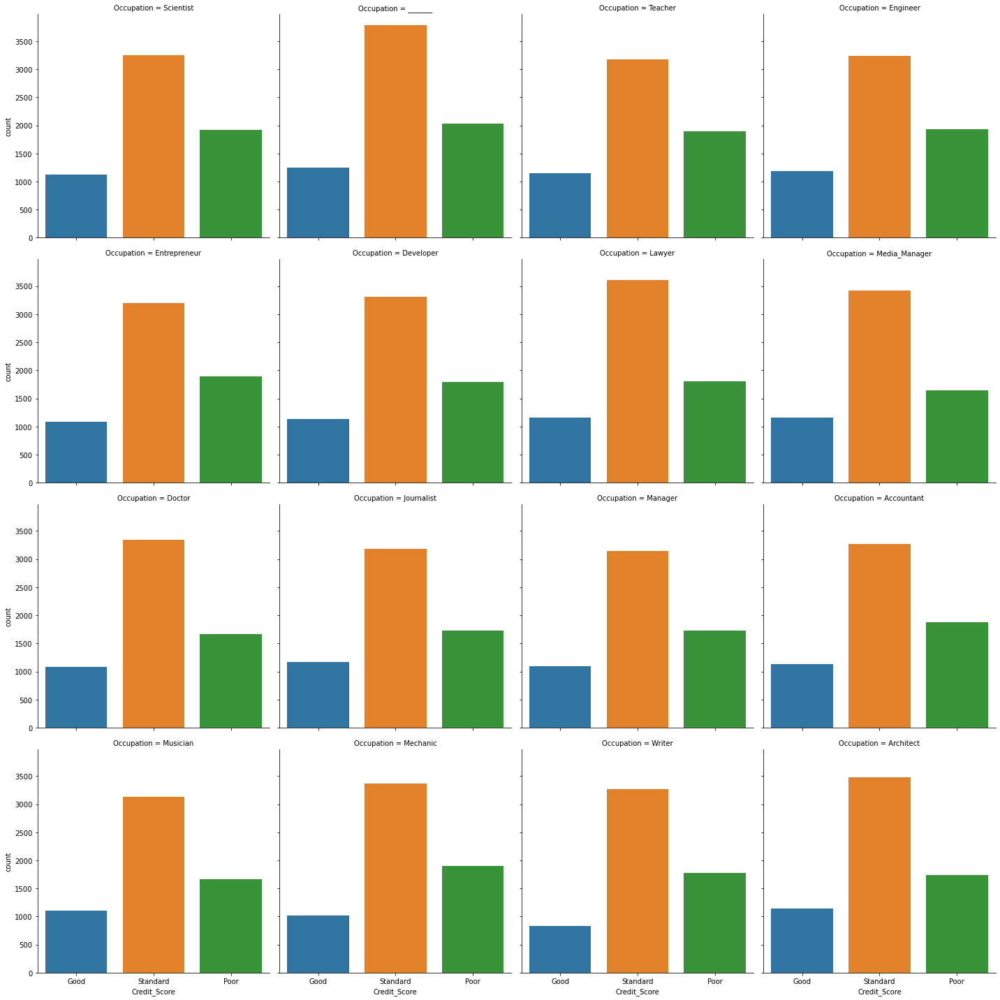

In [33]:
sns.factorplot('Credit_Score', col = 'Occupation', data = train, kind = 'count', col_wrap = 4)

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


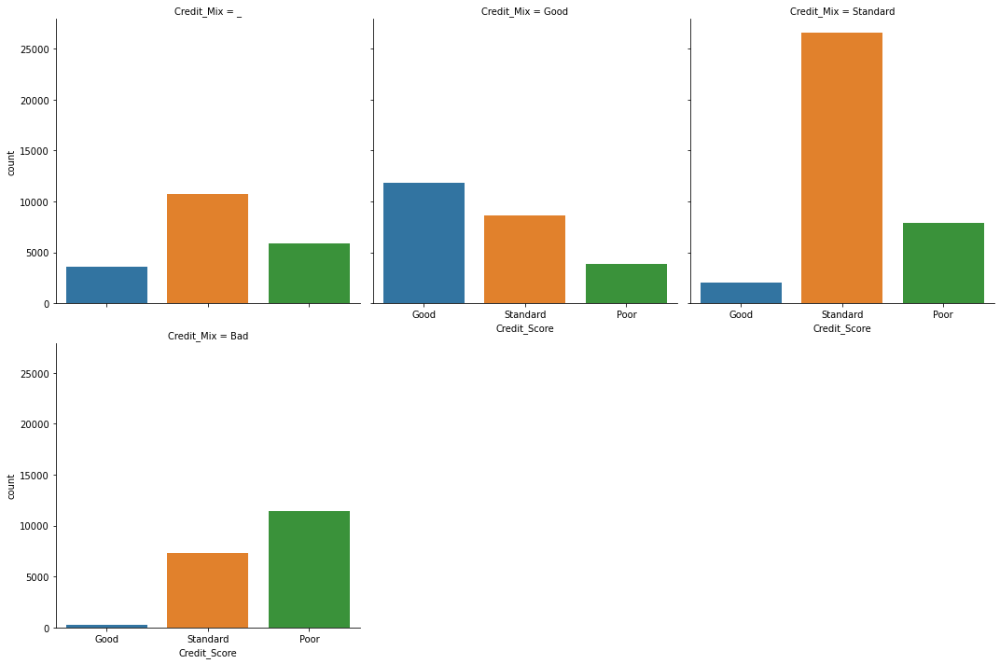

In [34]:

sns.factorplot('Credit_Score', col = 'Credit_Mix', data = train, kind = 'count', col_wrap = 3)

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


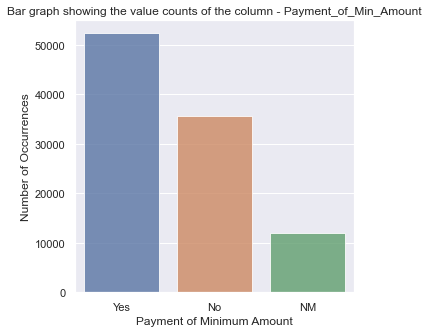

In [35]:
### Bar graph showing the value counts of the column - Payment_of_Min_Amount
min_amount_count = train['Payment_of_Min_Amount'].value_counts(dropna = False)
min_amount_count
sns.set(rc = {'figure.figsize': (5, 5)})
sns.barplot(min_amount_count.index, min_amount_count.values, alpha = 0.8)
plt.title('Bar graph showing the value counts of the column - Payment_of_Min_Amount')
plt.ylabel('Number of Occurrences', fontsize = 12)
plt.xlabel('Payment of Minimum Amount', fontsize = 12)
plt.show()

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar fle

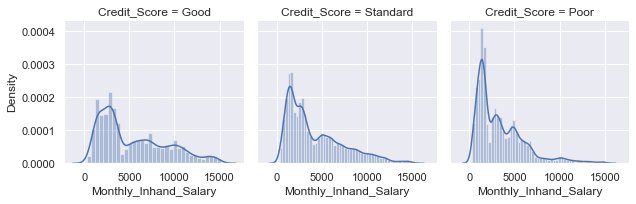

In [36]:
### Monthly Inhand Salary distribution by Credit Score

grid = sns.FacetGrid(train, col = 'Credit_Score')
grid.map(sns.distplot, 'Monthly_Inhand_Salary')

Text(0.5, 1.0, 'Customer Monthly Inhand Salary by Credit Score')

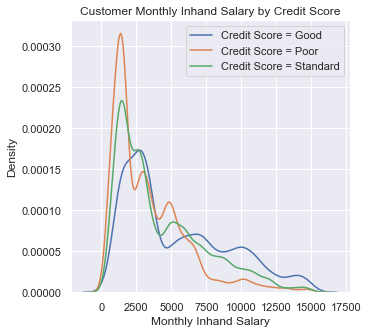

In [37]:
### Merging the above graphs into one

sns.kdeplot(train['Monthly_Inhand_Salary'][train['Credit_Score'] == 'Good'], label = 'Credit Score = Good')
sns.kdeplot(train['Monthly_Inhand_Salary'][train['Credit_Score'] == 'Poor'], label = 'Credit Score = Poor')
sns.kdeplot(train['Monthly_Inhand_Salary'][train['Credit_Score'] == 'Standard'], label = 'Credit Score = Standard')
plt.xlabel('Monthly Inhand Salary')
plt.legend()
plt.title('Customer Monthly Inhand Salary by Credit Score')

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Customers Interest Rate Distribution')

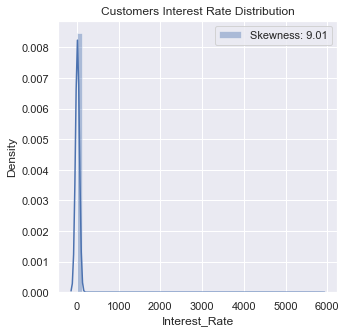

In [38]:
### Understanding the distribution of the column - Interest_Rate

sns.distplot(train['Interest_Rate'], label = 'Skewness: %.2f'%(train['Interest_Rate'].skew()))
plt.legend(loc = 'best')
plt.title('Customers Interest Rate Distribution')

# EDA

In [39]:
for i in train.columns:
    print(f" unique values = {i}")
    print(train[i].value_counts())
    print("------------------------------------------------------")

 unique values = ID
0x1602     1
0x19c88    1
0x19caa    1
0x19ca5    1
0x19ca4    1
          ..
0xd94d     1
0xd94c     1
0xd94b     1
0xd94a     1
0x25fed    1
Name: ID, Length: 100000, dtype: int64
------------------------------------------------------
 unique values = Customer_ID
CUS_0xd40     8
CUS_0x9bf4    8
CUS_0x5ae3    8
CUS_0xbe9a    8
CUS_0x4874    8
             ..
CUS_0x2eb4    8
CUS_0x7863    8
CUS_0x9d89    8
CUS_0xc045    8
CUS_0x942c    8
Name: Customer_ID, Length: 12500, dtype: int64
------------------------------------------------------
 unique values = Month
January     12500
February    12500
March       12500
April       12500
May         12500
June        12500
July        12500
August      12500
Name: Month, dtype: int64
------------------------------------------------------
 unique values = Name
Langep            44
Stevex            44
Vaughanl          39
Jessicad          39
Raymondr          38
                  ..
Alina Selyukhg     4
Habboushg          

Standard    53174
Poor        28998
Good        17828
Name: Credit_Score, dtype: int64
------------------------------------------------------


In [40]:
for i in test.columns:
    print(f" unique values = {i}")
    print(test[i].value_counts())
    print("------------------------------------------------------")

 unique values = ID
0x160a     1
0x19cd8    1
0x19c9a    1
0x19c9b    1
0x19c9c    1
          ..
0xd95e     1
0xd95f     1
0xd960     1
0xd961     1
0x25ff1    1
Name: ID, Length: 50000, dtype: int64
------------------------------------------------------
 unique values = Customer_ID
CUS_0xd40     4
CUS_0x9bf4    4
CUS_0x5ae3    4
CUS_0xbe9a    4
CUS_0x4874    4
             ..
CUS_0x2eb4    4
CUS_0x7863    4
CUS_0x9d89    4
CUS_0xc045    4
CUS_0x942c    4
Name: Customer_ID, Length: 12500, dtype: int64
------------------------------------------------------
 unique values = Month
September    12500
October      12500
November     12500
December     12500
Name: Month, dtype: int64
------------------------------------------------------
 unique values = Name
Stevex                22
Langep                21
Raymondr              20
Deepa Seetharamanm    20
Ronald Groverk        20
                      ..
Nicolaq                1
Alexei Oreskovicn      1
Herbert Lashx          1
Sarah N.y 

In [41]:
df = pd.concat([train, test], ignore_index=True)
df.shape

(150000, 28)

**Identify issues**
1. ID, Name and SSN (Not useful)
2. Age, Annual_Income, Num_of_Loan, Num_of_Delayed_Payment, Changed_Credit_Limit, Amount_invested_monthly, Outstanding_Debt Credit_Mix, Monthly_Balance Numerical but show as catogery (need to be fixed)
3. Occupation, CreditMix has value "__"
4. Data contains outliers
5. Num_Credit_Card has zeros
6. Type_of_Loan Need to rewrite as 8 columns
7. Num_Bank_Accounts contains negative values
8. Credit_History_Age,Payment_of_Min_Amount,Payment_Behaviour,'Credit_Mix' (needs Feature Engineering)
9. Target Columns is Imbalanced
10. A lot of missing data

# Data Cleaning:


In [42]:
train = train.applymap(lambda x: x if x is np.NaN or not isinstance(x, str) else str(x).strip('_ ,"')
                      ).replace(['', 'nan', '!@9#%8', '#F%$D@*&8'], np.NaN)
train

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,0x25fe9,CUS_0x942c,April,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.97133255718485,High_spent_Large_value_payments,479.866228,Poor
99996,0x25fea,CUS_0x942c,May,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.18595028760385,High_spent_Medium_value_payments,496.65161,Poor
99997,0x25feb,CUS_0x942c,June,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.02847744864441,High_spent_Large_value_payments,516.809083,Poor
99998,0x25fec,CUS_0x942c,July,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.67258219721603,Low_spent_Large_value_payments,319.164979,Standard


In [43]:
test = test.applymap(lambda x: x if x is np.NaN or not isinstance(x, str) else str(x).strip('_ ,"')
                      ).replace(['', 'nan', '!@9#%8', '#F%$D@*&8'], np.NaN)
test

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,NaN,3,...,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,NaN,34847.84,3037.986667,2,...,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,0x25fe5,CUS_0x8600,December,Sarah McBridec,4975,031-35-0942,Architect,20002.88,1929.906667,10,...,12.0,NaN,3571.7,34.780553,NaN,Yes,60.964772,146.48632477751087,Low_spent_Small_value_payments,275.53956951573343
49996,0x25fee,CUS_0x942c,September,Nicks,25,078-73-5990,Mechanic,39628.99,NaN,4,...,7.0,Good,502.38,27.758522,31 Years and 11 Months,NM,35.104023,181.44299902757518,Low_spent_Small_value_payments,409.39456169535066
49997,0x25fef,CUS_0x942c,October,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,7.0,Good,502.38,36.858542,32 Years and 0 Months,No,35.104023,10000,Low_spent_Large_value_payments,349.7263321025098
49998,0x25ff0,CUS_0x942c,November,Nicks,25,078-73-5990,Mechanic,39628.99,NaN,4,...,7.0,Good,502.38,39.139840,32 Years and 1 Months,No,35.104023,97.59857973344877,High_spent_Small_value_payments,463.23898098947717


In [44]:
train['ID'] = train.ID.apply(lambda x: int(x, 16))
test['ID'] = test.ID.apply(lambda x: int(x, 16))

In [45]:
train['Customer_ID'] = train.Customer_ID.apply(lambda x: int(x[4:], 16))
test['Customer_ID'] = test.Customer_ID.apply(lambda x: int(x[4:], 16))

In [46]:
train['Month'] = pd.to_datetime(train.Month, format='%B').dt.month
test['Month'] = pd.to_datetime(test.Month, format='%B').dt.month

In [47]:
train['Age'] = train.Age.astype(int)   
test['Age'] = test.Age.astype(int)   

In [48]:
train['SSN'] = train.SSN.apply(lambda x: x if x is np.NaN else int(str(x).replace('-', ''))).astype(float)
test['SSN'] =test.SSN.apply(lambda x: x if x is np.NaN else int(str(x).replace('-', ''))).astype(float)

In [49]:
train['Annual_Income'] = train.Annual_Income.astype(float)
train['Num_of_Loan'] = train.Num_of_Loan.astype(int) 
train['Num_of_Delayed_Payment'] = train.Num_of_Delayed_Payment.astype(float)
train['Changed_Credit_Limit'] = train.Changed_Credit_Limit.astype(float)
train['Outstanding_Debt'] = train.Outstanding_Debt.astype(float)
train['Amount_invested_monthly'] = train.Amount_invested_monthly.astype(float)
train['Monthly_Balance'] = train.Monthly_Balance.astype(float)
train["Interest_Rate"] = train["Interest_Rate"].astype("float64")


In [50]:
test['Annual_Income'] = test.Annual_Income.astype(float)
test['Num_of_Loan'] = test.Num_of_Loan.astype(int) 
test['Num_of_Delayed_Payment'] = test.Num_of_Delayed_Payment.astype(float)
test['Changed_Credit_Limit'] = test.Changed_Credit_Limit.astype(float)
test['Outstanding_Debt'] = test.Outstanding_Debt.astype(float)
test['Amount_invested_monthly'] = test.Amount_invested_monthly.astype(float)
test['Monthly_Balance'] = test.Monthly_Balance.astype(float)
train["Interest_Rate"] = train["Interest_Rate"].astype("float64")


In [51]:
train.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,-500,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


In [52]:
def Month_Converter(x):
    if pd.notnull(x):
        num1 = int(x.split(' ')[0])
        num2 = int(x.split(' ')[3])
      
        return (num1*12)+num2
    else:
        return x
train['Credit_History_Age'] = train.Credit_History_Age.apply(lambda x: Month_Converter(x)).astype(float)
test['Credit_History_Age'] = test.Credit_History_Age.apply(lambda x: Month_Converter(x)).astype(float)

In [53]:
train

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,265.0,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,-500,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,267.0,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,268.0,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,269.0,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,155625,37932,4,Nicks,25,78735990.0,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,34.663572,378.0,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,155626,37932,5,Nicks,25,78735990.0,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,40.565631,379.0,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor
99997,155627,37932,6,Nicks,25,78735990.0,Mechanic,39628.99,3359.415833,4,...,Good,502.38,41.255522,380.0,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,155628,37932,7,Nicks,25,78735990.0,Mechanic,39628.99,3359.415833,4,...,Good,502.38,33.638208,381.0,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard


In [54]:
train["Amount_invested_monthly"] = train["Amount_invested_monthly"].replace("__10000__", 10000.00)
train["Monthly_Balance"] = train["Monthly_Balance"].replace("__-333333333333333333333333333__", 0)
train["Num_of_Delayed_Payment"] = train["Num_of_Delayed_Payment"].replace(r"_$", "", regex=True)
train["Annual_Income"] = train["Annual_Income"].replace(r"_$", "", regex=True)
train["Age"] = train["Age"].replace(r"_$", "", regex=True)
train["Outstanding_Debt"] = train["Outstanding_Debt"].replace(r"_$", "", regex=True)
train["Occupation"] = train["Occupation"].replace("_______", np.nan)
train["Num_of_Loan"] = train["Num_of_Loan"].replace(r"_$", "", regex=True)
train["Credit_Mix"] = train["Credit_Mix"].replace("_", np.nan)
train["Changed_Credit_Limit"] = train["Changed_Credit_Limit"].replace("_", 0)


In [55]:
test["Amount_invested_monthly"] = test["Amount_invested_monthly"].replace("__10000__", 10000.00)
test["Monthly_Balance"] = test["Monthly_Balance"].replace("__-333333333333333333333333333__", 0)
test["Num_of_Delayed_Payment"] = test["Num_of_Delayed_Payment"].replace(r"_$", "", regex=True)
test["Annual_Income"] = test["Annual_Income"].replace(r"_$", "", regex=True)
test["Age"] = test["Age"].replace(r"_$", "", regex=True)
test["Outstanding_Debt"] = test["Outstanding_Debt"].replace(r"_$", "", regex=True)
test["Occupation"] = test["Occupation"].replace("_______", np.nan)
test["Num_of_Loan"] = test["Num_of_Loan"].replace(r"_$", "", regex=True)
test["Credit_Mix"] = test["Credit_Mix"].replace("_", np.nan)
test["Changed_Credit_Limit"] = test["Changed_Credit_Limit"].replace("_", 0)


In [56]:
train.Age.replace(-500, np.median(train.Age), inplace=True)
for i in train.Age.values:
    if i > 118:
        train.Age.replace(i, np.median(train.Age), inplace=True)

test.Age.replace(-500, np.median(test.Age), inplace=True)
for i in test.Age.values:
    if i > 118:
        test.Age.replace(i, np.median(test.Age), inplace=True)

In [57]:
train.Num_of_Loan.replace(-100, np.median(train.Num_of_Loan), inplace=True)
for i in train.Num_of_Loan.values:
    if i > 10:
        train.Num_of_Loan.replace(i, np.median(train.Num_of_Loan), inplace=True)

test.Num_of_Loan.replace(-100, np.median(test.Num_of_Loan), inplace=True)
for i in test.Num_of_Loan.values:
    if i > 10:
        test.Num_of_Loan.replace(i, np.median(test.Num_of_Loan), inplace=True)

In [58]:
for i in train.Interest_Rate:
    if i > 20:
        train.Interest_Rate.replace(i, np.median(train.Interest_Rate), inplace=True)

for i in test.Interest_Rate:
    if i > 20:
        test.Interest_Rate.replace(i, np.median(test.Interest_Rate), inplace=True)

In [59]:
for i in train.Num_Bank_Accounts:
    if i > 100:
        train.Num_Bank_Accounts.replace(i, np.median(train.Num_Bank_Accounts), inplace=True)


for i in test.Num_Bank_Accounts:
    if i > 100:
        test.Num_Bank_Accounts.replace(
            i, np.median(test.Num_Bank_Accounts), inplace=True
        )

In [60]:
for i in train.Num_Credit_Card:
    if i > 50:
        train.Num_Credit_Card.replace(i, np.median(train.Num_Credit_Card), inplace=True)


for i in test.Num_Credit_Card:
    if i > 50:
        test.Num_Credit_Card.replace(i, np.median(test.Num_Credit_Card), inplace=True)

In [61]:
train.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,265.0,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,33,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,267.0,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23,821000265.0,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,268.0,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23,821000265.0,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,269.0,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


In [62]:
train.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                          5572
Occupation                   7062
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit         2091
Num_Credit_Inquiries         1965
Credit_Mix                  20195
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour            7600
Monthly_Balance              1200
Credit_Score                    0
dtype: int64

In [63]:
imp = KNNImputer(n_neighbors=3)


def filling_na(df, column, type_=None):
    """
    This fucntion for filling null values to work with the data properly
    Parameters:
    df: DataFrame to fill the na with
    column: column which will fill the value in it
    type_: type of data needed be filled

    """
    np.random.seed(7)
    if type_ == "num":
        # filling_list = df[column].dropna()
        # df[column] = df[column].fillna(
        #   pd.Series(np.random.choice(filling_list, size=len(df.index)))
        # )
        df[column] = imp.fit_transform(df[column].values.reshape(-1, 1))

    else:
        filling_list = df[column].dropna().unique()
        df[column] = df[column].fillna(
            pd.Series(np.random.choice(filling_list, size=len(df.index)))
        )
    return df[column]

In [64]:
train["Monthly_Inhand_Salary"] = filling_na(train, "Monthly_Inhand_Salary", "num")
train["Num_Credit_Inquiries"] = filling_na(train, "Num_Credit_Inquiries", "num")
train["Amount_invested_monthly"] = filling_na(train, "Amount_invested_monthly", "num")
train["Num_of_Delayed_Payment"] = filling_na(train, "Num_of_Delayed_Payment", "num")
train["Monthly_Balance"] = filling_na(train, "Monthly_Balance", "num")
train["Type_of_Loan"] = filling_na(train, "Type_of_Loan")
train["Credit_History_Age"] = filling_na(train, "Credit_History_Age")
train["Occupation"] = filling_na(train, "Occupation")


test["Monthly_Inhand_Salary"] = filling_na(test, "Monthly_Inhand_Salary", "num")
test["Num_Credit_Inquiries"] = filling_na(test, "Num_Credit_Inquiries", "num")
test["Amount_invested_monthly"] = filling_na(test, "Amount_invested_monthly", "num")
test["Num_of_Delayed_Payment"] = filling_na(test, "Num_of_Delayed_Payment", "num")
test["Monthly_Balance"] = filling_na(test, "Monthly_Balance", "num")
test["Type_of_Loan"] = filling_na(test, "Type_of_Loan")
test["Credit_History_Age"] = filling_na(test, "Credit_History_Age")
test["Occupation"] = filling_na(test, "Occupation")

In [65]:
train.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                          5572
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary           0
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                    0
Delay_from_due_date             0
Num_of_Delayed_Payment          0
Changed_Credit_Limit         2091
Num_Credit_Inquiries            0
Credit_Mix                  20195
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age              0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly         0
Payment_Behaviour            7600
Monthly_Balance                 0
Credit_Score                    0
dtype: int64

In [66]:
train.drop(
    [
        "Name",
        "Credit_History_Age",
        "ID",
        "Customer_ID",
        "SSN",
    ],
    axis=1,
    inplace=True,
)


In [67]:

test.drop_duplicates(subset="ID", inplace=True)
test.drop(
    [
        "Name",
        "Credit_History_Age",
        "ID",
        "Customer_ID",
        "SSN",
    ],
    axis=1,
    inplace=True,
)

In [68]:
train.Type_of_Loan = train.Type_of_Loan.str.replace("and", "")
train.Type_of_Loan = train.Type_of_Loan.str.replace(" ", "")

test.Type_of_Loan = test.Type_of_Loan.str.replace("and", "")
test.Type_of_Loan = test.Type_of_Loan.str.replace(" ", "")

cat_values = []
loan_cat = train.Type_of_Loan.unique()
for i in loan_cat:
    for j in i.split(","):
        cat_values.append(j)

loan_types = set([x.strip(" ") for x in set(cat_values)])
loan_types = list(loan_types)
loan_types

['HomeEquityLoan',
 'AutoLoan',
 'MortgageLoan',
 'Credit-BuilderLoan',
 'DebtConsolidationLoan',
 'PersonalLoan',
 'PaydayLoan',
 'NotSpecified',
 'StudentLoan']

In [69]:
index_values = ~train['Type_of_Loan'].isnull().values
loan_type_data = list(train['Type_of_Loan'][index_values])
loan_type_dict = dict()
for value in loan_type_data:
    values = value.split(',')
    for each_value in values:
        loan_type = each_value.strip(' ')
        if 'and' in loan_type:
            loan_type = loan_type[4 : ]
        if loan_type in loan_type_dict:
            loan_type_dict[loan_type] += 1
        else:
            loan_type_dict[loan_type] = 1

loan_type_dict

{'AutoLoan': 44625,
 'Credit-BuilderLoan': 47700,
 'PersonalLoan': 45652,
 'HomeEquityLoan': 46069,
 'NotSpecified': 46524,
 'MortgageLoan': 45863,
 'PaydayLoan': 47755,
 'DebtConsolidationLoan': 45561,
 'StudentLoan': 45771}

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 0, 'Type_of_Loan')

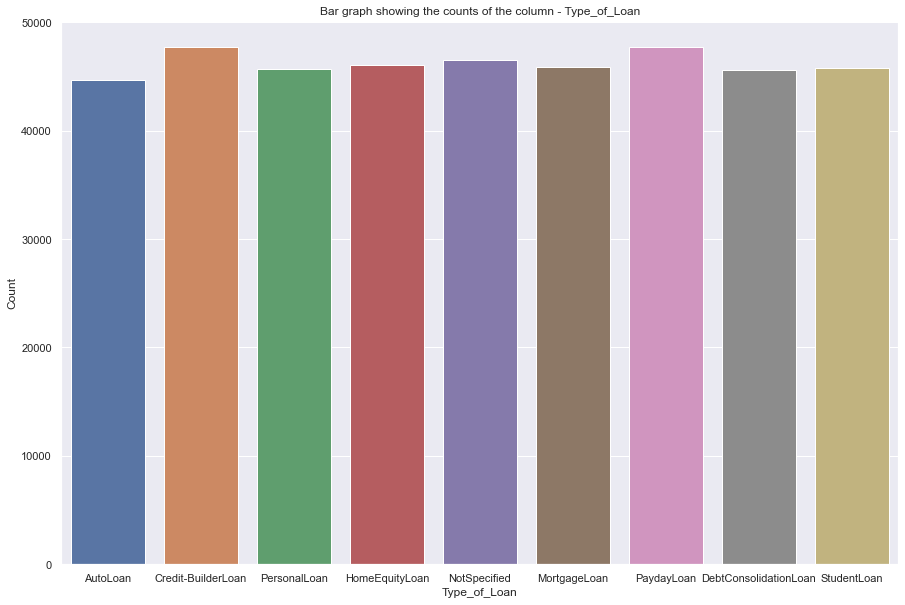

In [70]:
### Bar graph showing the counts of the column - Type_of_Loan

sns.set(rc = {'figure.figsize': (15, 10)})
sns.barplot(list(loan_type_dict.keys()), list(loan_type_dict.values()))
plt.title('Bar graph showing the counts of the column - Type_of_Loan')
plt.ylabel('Count', fontsize = 12)
plt.xlabel('Type_of_Loan', fontsize = 12)

In [71]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
Month,100000.0,4.500000e+00,2.291299e+00,1.000000e+00,2.750000,4.500000,6.250000,8.000000e+00
Age,100000.0,3.331899e+01,1.064554e+01,1.400000e+01,25.000000,33.000000,41.000000,1.180000e+02
Annual_Income,100000.0,1.764157e+05,1.429618e+06,7.005930e+03,19457.500000,37578.610000,72790.920000,2.419806e+07
Monthly_Inhand_Salary,100000.0,4.194171e+03,2.935176e+03,3.036454e+02,1792.084167,3852.736667,5371.525000,1.520463e+04
Num_Bank_Accounts,100000.0,5.410010e+00,2.951401e+00,-1.000000e+00,3.000000,6.000000,7.000000,1.000000e+02
Num_Credit_Card,100000.0,5.536430e+00,2.151232e+00,0.000000e+00,4.000000,5.000000,7.000000,5.000000e+01
Interest_Rate,100000.0,1.126291e+01,4.878230e+00,1.000000e+00,8.000000,13.000000,14.000000,2.000000e+01
Num_of_Loan,100000.0,3.510550e+00,2.395985e+00,0.000000e+00,2.000000,3.000000,5.000000,9.000000e+00
Delay_from_due_date,100000.0,2.106878e+01,1.486010e+01,-5.000000e+00,10.000000,18.000000,28.000000,6.700000e+01
Num_of_Delayed_Payment,100000.0,3.092334e+01,2.179748e+02,-3.000000e+00,9.000000,15.000000,19.000000,4.397000e+03


In [72]:
train.describe(include="O").T

,count,unique,top,freq
Occupation,100000,15,Lawyer,7093
Type_of_Loan,100000,6260,NotSpecified,1409
Credit_Mix,79805,3,Standard,36479
Payment_of_Min_Amount,100000,3,Yes,52326
Payment_Behaviour,92400,6,Low_spent_Small_value_payments,25513
Credit_Score,100000,3,Standard,53174


In [73]:
train.groupby(by=["Credit_Score"]).size().reset_index(name="counts")


,Credit_Score,counts
0,Good,17828
1,Poor,28998
2,Standard,53174


# Data Visualization

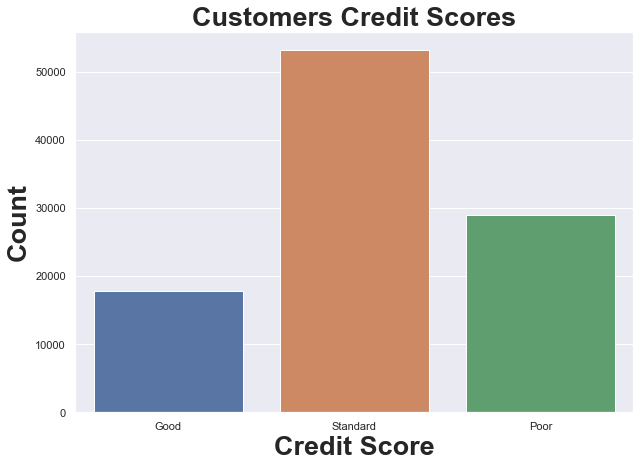

In [74]:
plt.figure(figsize=(10, 7))
sns.countplot(data=train, x="Credit_Score")
plt.title("Customers Credit Scores", size=27, fontweight="bold")
plt.xlabel("Credit Score", size=27, fontweight="bold")
plt.ylabel("Count", size=27, fontweight="bold")
plt.show()

In [77]:
px.bar(data_frame = train.groupby(by=["Credit_Score"]).size().reset_index(name="counts"), 
       x="Credit_Score", y="counts", barmode="group")

**observation** 
1. most of people lying under standard credit score

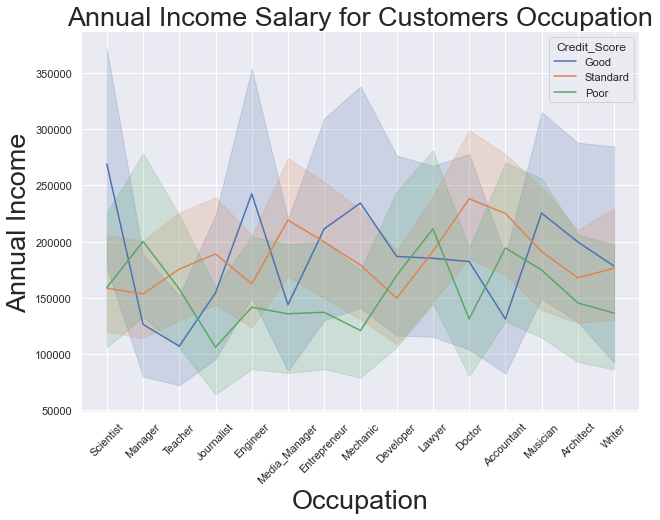

In [78]:
plt.figure(figsize=(10, 7))
sns.lineplot(data=train, x="Occupation", y="Annual_Income", hue="Credit_Score")
plt.xticks(rotation=45)
plt.title("Annual Income Salary for Customers Occupation", size=27)
plt.xlabel("Occupation", size=27 )
plt.ylabel("Annual Income", size=27)
plt.show()

In [79]:
px.line(data_frame=train, x="Occupation", y="Annual_Income",color="Credit_Score")

In [80]:
px.line_3d(data_frame=train, x="Occupation", y="Annual_Income",z="Credit_Score")

**observation**

The Annual Income of the Cutomers doesn't affect on the credit score as we see that the variance on the annual income and the people can still have a good credit score whether the cutomer has a 100000 USD or 250000 USD Annually

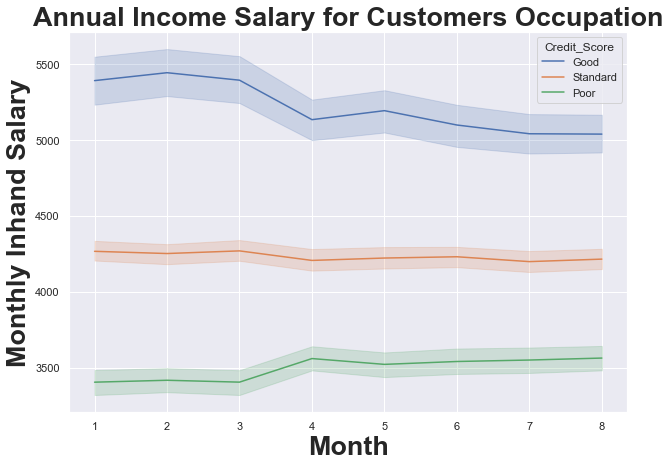

In [81]:
plt.figure(figsize=(10, 7))
sns.lineplot(data=train, x="Month", y="Monthly_Inhand_Salary", hue="Credit_Score")
plt.title("Annual Income Salary for Customers Occupation", size=27, fontweight="bold")
plt.xlabel("Month", size=27, fontweight="bold")
plt.ylabel("Monthly Inhand Salary", size=27, fontweight="bold")
plt.show()

In [82]:
px.line(data_frame=train, x="Month", y="Monthly_Inhand_Salary",color="Credit_Score")

1. People who has a high inhand monthly salary have a good credit score and who has a low inhand salary has a low credit score

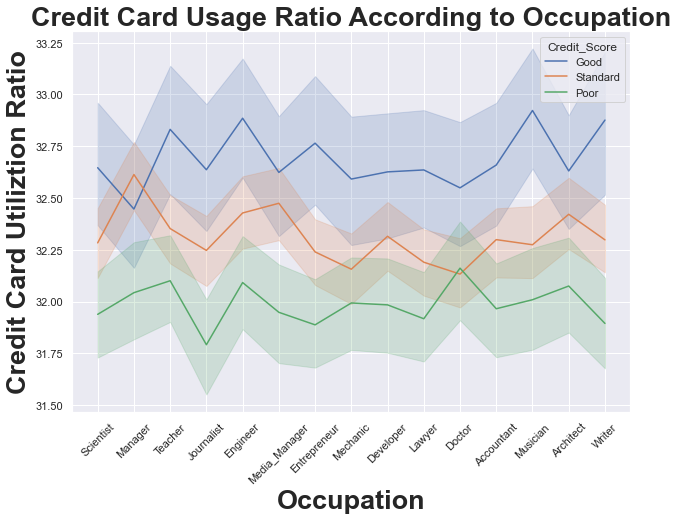

In [83]:
plt.figure(figsize=(10, 7))
sns.lineplot(data=train, x="Occupation", y="Credit_Utilization_Ratio", hue="Credit_Score")
plt.xticks(rotation=45)
plt.title("Credit Card Usage Ratio According to Occupation", size=27, fontweight="bold")
plt.xlabel("Occupation", size=27, fontweight="bold")
plt.ylabel("Credit Card Utiliztion Ratio", size=27, fontweight="bold")
plt.show()

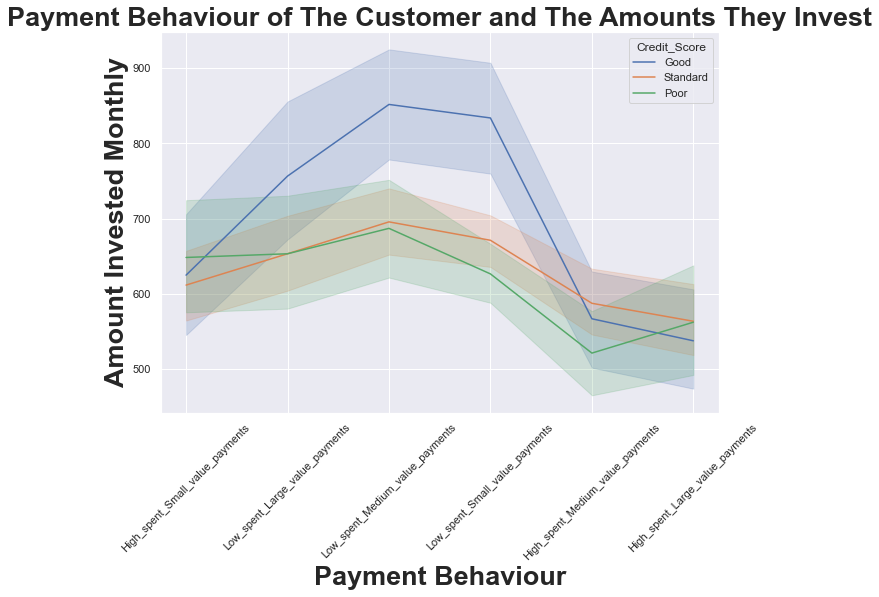

In [84]:
plt.figure(figsize=(10, 7))
sns.lineplot(
    data=train, x="Payment_Behaviour", y="Amount_invested_monthly", hue="Credit_Score"
)
plt.xticks(rotation=45)
plt.title(
    "Payment Behaviour of The Customer and The Amounts They Invest",
    size=27,
    fontweight="bold",
)
plt.xlabel("Payment Behaviour", size=27, fontweight="bold")
plt.ylabel("Amount Invested Monthly", size=27, fontweight="bold")
plt.show()

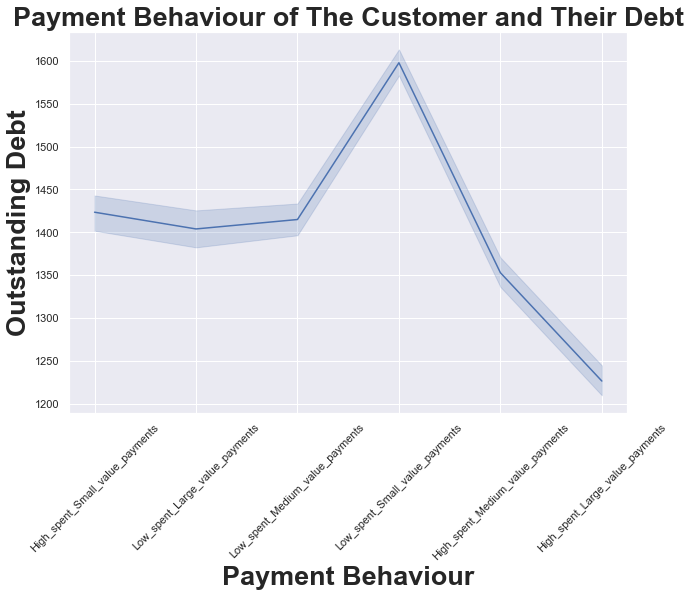

In [85]:
plt.figure(figsize=(10, 7))
sns.lineplot(data=train , x="Payment_Behaviour", y="Outstanding_Debt")
plt.xticks(rotation=45)
plt.title(
    "Payment Behaviour of The Customer and Their Debt", size=27, fontweight="bold"
)
plt.xlabel("Payment Behaviour", size=27, fontweight="bold")
plt.ylabel("Outstanding Debt", size=27, fontweight="bold")
plt.show()

In [86]:
px.line(data_frame=train, x="Payment_Behaviour", y="Outstanding_Debt",)

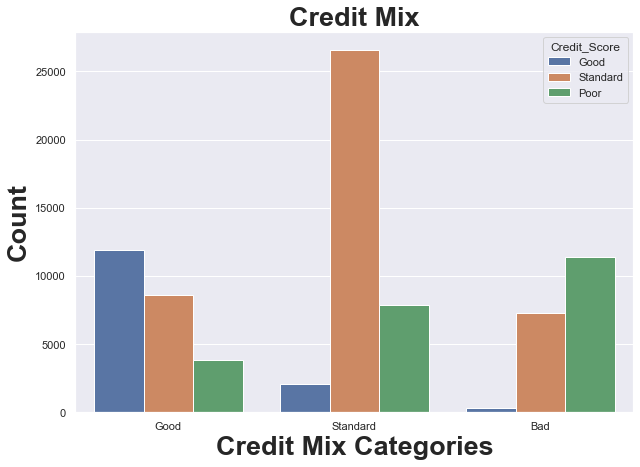

In [87]:
plt.figure(figsize=(10, 7))
sns.countplot(data=train, x="Credit_Mix", hue="Credit_Score")
# plt.xticks(rotation=45)
plt.title("Credit Mix", size=27, fontweight="bold")
plt.xlabel("Credit Mix Categories", size=27, fontweight="bold")
plt.ylabel("Count", size=27, fontweight="bold")
plt.show()

In [88]:

px.bar(data_frame=train.groupby(by=["Credit_Mix", "Credit_Score"]).size().reset_index(name="counts"),
       x="Credit_Mix", y="counts", color="Credit_Score", barmode="group")

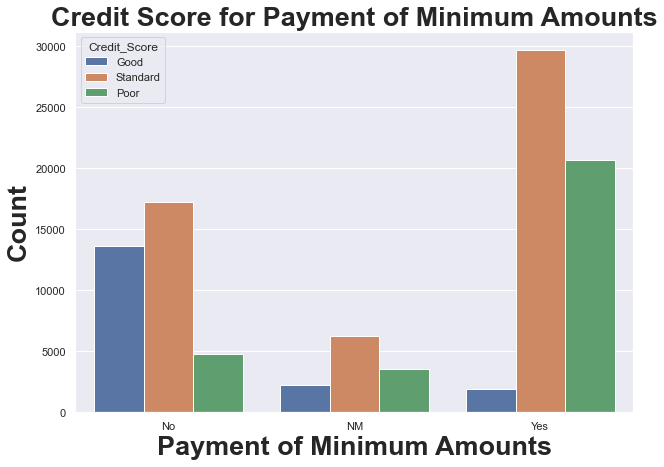

In [89]:
plt.figure(figsize=(10, 7))
sns.countplot(data=train, x="Payment_of_Min_Amount", hue="Credit_Score")
plt.title("Credit Score for Payment of Minimum Amounts", size=27, fontweight="bold")
plt.xlabel("Payment of Minimum Amounts", size=27, fontweight="bold")
plt.ylabel("Count", size=27, fontweight="bold")
plt.show()

In [90]:
px.bar(data_frame=train.groupby(by=["Payment_of_Min_Amount", "Credit_Score"]).size().reset_index(name="counts"),
       x="Payment_of_Min_Amount", y="counts", color="Credit_Score", barmode="group")

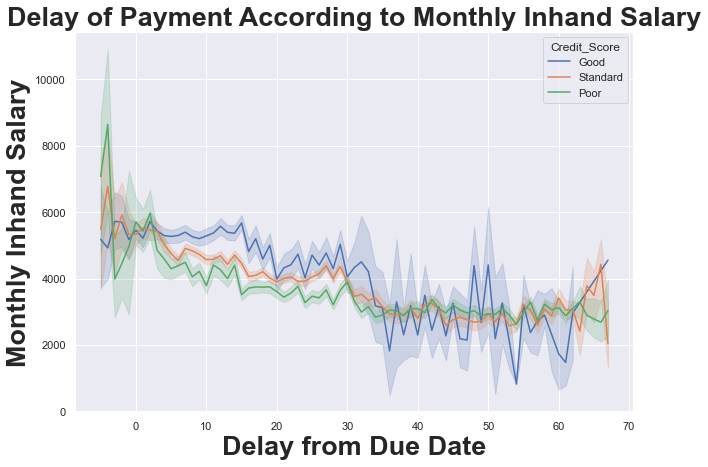

In [91]:
plt.figure(figsize=(10, 7))
sns.lineplot(
    data=train, x="Delay_from_due_date", y="Monthly_Inhand_Salary", hue="Credit_Score"
)
plt.title(
    "Delay of Payment According to Monthly Inhand Salary", size=27, fontweight="bold"
)
plt.xlabel("Delay from Due Date", size=27, fontweight="bold")
plt.ylabel("Monthly Inhand Salary", size=27, fontweight="bold")
plt.show()


In [92]:
train["Age_Group"] = pd.cut(
    train.Age,
    bins=[14, 25, 30, 45, 55, 95, 120],
    labels=["14-25", "25-30", "30-45", "45-55", "55-95", "95-120"],
)
age_groups = (
    train.groupby(["Age_Group", "Credit_Score"])[
        "Outstanding_Debt", "Annual_Income", "Num_Bank_Accounts", "Num_Credit_Card"
    ]
    .sum()
    .reset_index()
)
age_groups

C:\Users\Sumeet Maheshwari\AppData\Local\Temp\ipykernel_22676\45928403.py:7: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Age_Group,Credit_Score,Outstanding_Debt,Annual_Income,Num_Bank_Accounts,Num_Credit_Card
0,14-25,Good,3137180.79,6.649730e+08,13799,15490
1,14-25,Poor,19005227.84,1.430461e+09,59369,58506
2,14-25,Standard,19952090.01,2.223223e+09,79088,77066
3,25-30,Good,1825730.64,3.288637e+08,7940,9083
4,25-30,Poor,9617599.66,7.935326e+08,29979,29512
5,25-30,Standard,9651424.60,1.372142e+09,41370,40866
6,30-45,Good,6071054.67,1.351365e+09,25420,30938
7,30-45,Poor,28685654.13,1.908736e+09,89952,89917
8,30-45,Standard,31548539.35,4.717357e+09,130148,129358
9,45-55,Good,3116857.45,9.038921e+08,14801,18157


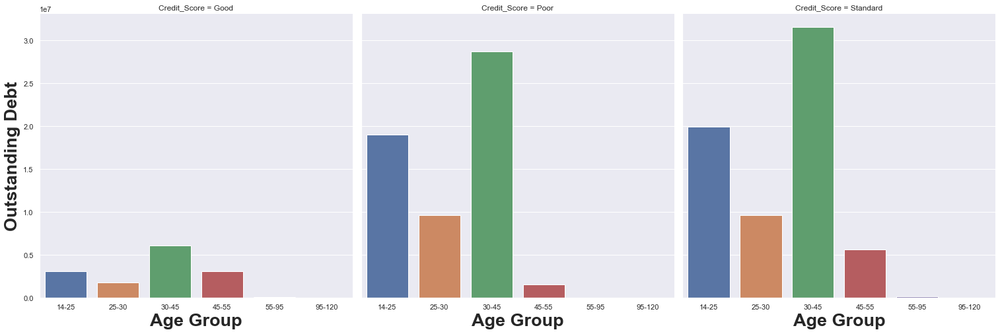

In [93]:
g = sns.catplot(
    data=age_groups,
    x="Age_Group",
    y="Outstanding_Debt",
    height=7,
    aspect=1,
    col="Credit_Score",
    kind="bar",
    ci=None,
)
g.set_axis_labels("Age Group", "Outstanding Debt", size=27, fontweight="bold")
plt.show()

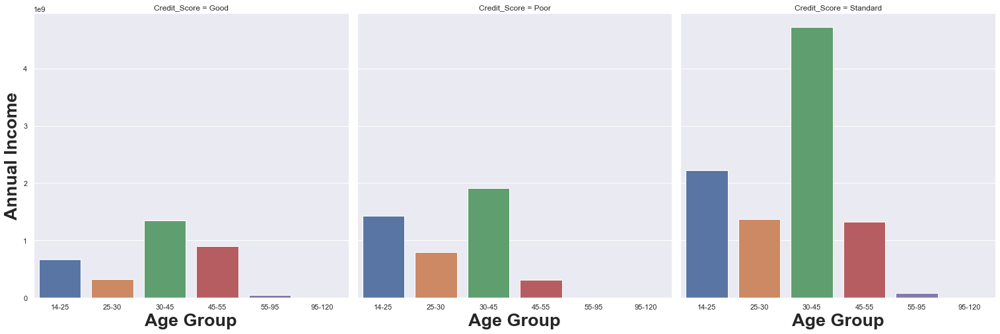

In [94]:
g = sns.catplot(
    data=age_groups,
    x="Age_Group",
    y="Annual_Income",
    height=7,
    aspect=1,
    col="Credit_Score",
    kind="bar",
    ci=None,
)
g.set_axis_labels("Age Group", "Annual Income", size=27, fontweight="bold")
plt.show()

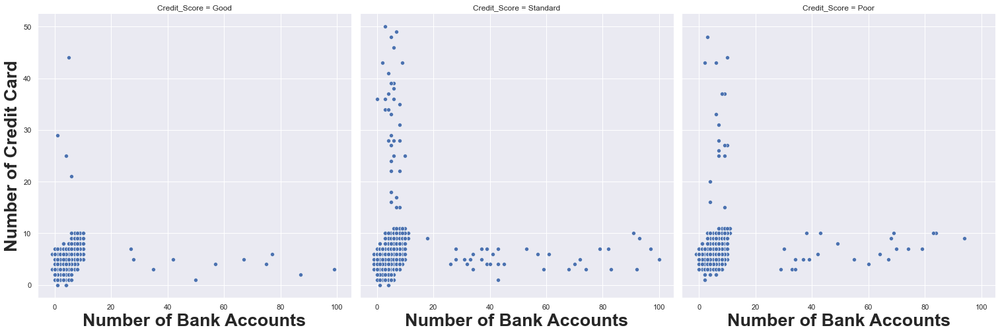

In [95]:
g = sns.relplot(
    data=train,
    x="Num_Bank_Accounts",
    y="Num_Credit_Card",
    col="Credit_Score",
    height=7,
    aspect=1,
)
g.set_axis_labels(
    "Number of Bank Accounts", "Number of Credit Card", size=27, fontweight="bold"
)
plt.show()


C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



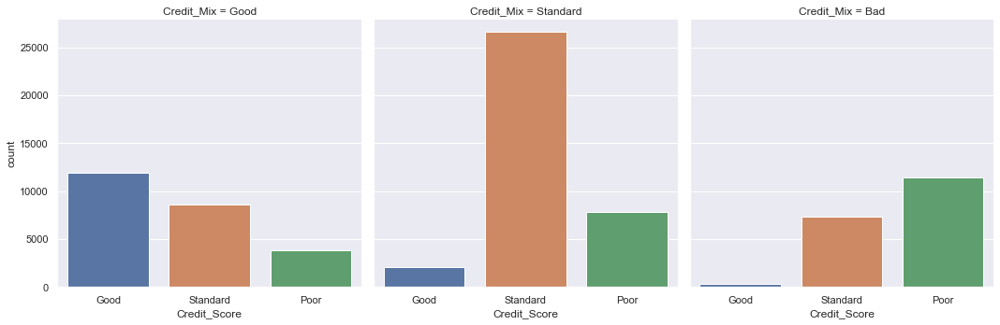

In [96]:

sns.factorplot('Credit_Score', col = 'Credit_Mix', data = train, kind = 'count', col_wrap = 3)

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



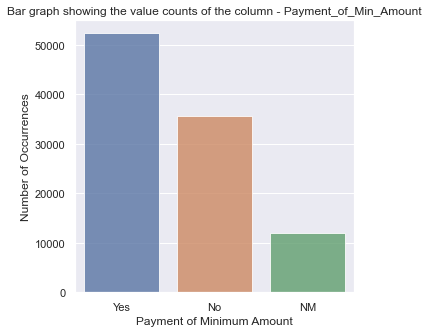

In [97]:
### Bar graph showing the value counts of the column - Payment_of_Min_Amount
min_amount_count = train['Payment_of_Min_Amount'].value_counts(dropna = False)
min_amount_count
sns.set(rc = {'figure.figsize': (5, 5)})
sns.barplot(min_amount_count.index, min_amount_count.values, alpha = 0.8)
plt.title('Bar graph showing the value counts of the column - Payment_of_Min_Amount')
plt.ylabel('Number of Occurrences', fontsize = 12)
plt.xlabel('Payment of Minimum Amount', fontsize = 12)
plt.show()

In [98]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calu_vif(dataset):
    vif = pd.DataFrame()
    vif['feature'] = dataset.columns
    vif['Vif_values'] = [variance_inflation_factor(dataset.values,i) for i in range(dataset.shape[1])]
    return vif


In [99]:
train.dropna(inplace=True)

In [100]:
num = train.select_dtypes(include=["int","float"])
num_cols= num.columns

In [101]:
calu_vif(num)

,feature,Vif_values
0,Month,0.205781
1,Age,0.089240
2,Annual_Income,0.984871
3,Monthly_Inhand_Salary,0.328545
4,Num_Bank_Accounts,0.231560
5,Num_Credit_Card,0.131467
6,Interest_Rate,0.159788
7,Num_of_Loan,0.318146
8,Delay_from_due_date,0.333645
9,Num_of_Delayed_Payment,0.980404


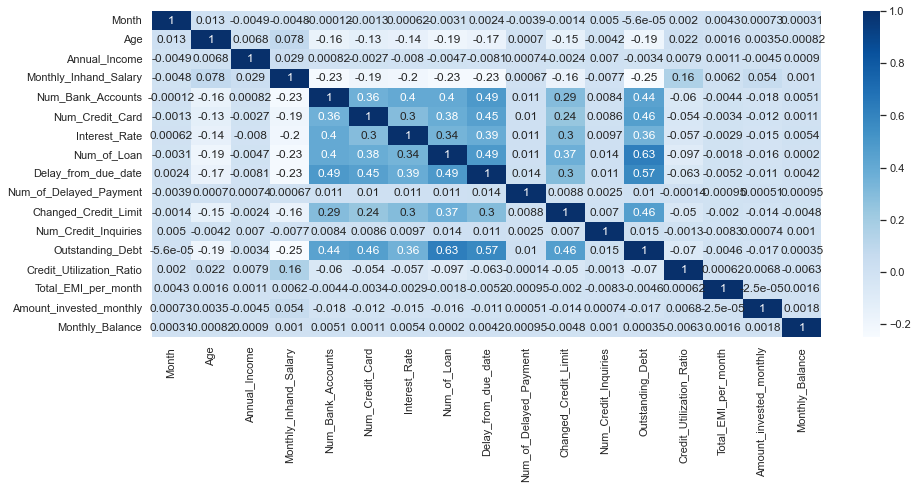

In [102]:
plt.figure(figsize=(15,6))

sns.heatmap(num.corr(), annot= True, cmap="Blues")
plt.show()

In [103]:
def box_plot(df_c, num_cols):
    plt.figure(figsize=(20, 15))
    for i in range(len(num_cols)):
        if i == 16:
            break
        else:
            plt.subplot(4,4, i+1)
            l = num_cols[i]
            sns.boxplot(df_c[l], palette="flare")

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\Sumeet Maheshwari\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\Sumeet Maheshwari\anaconda3\lib

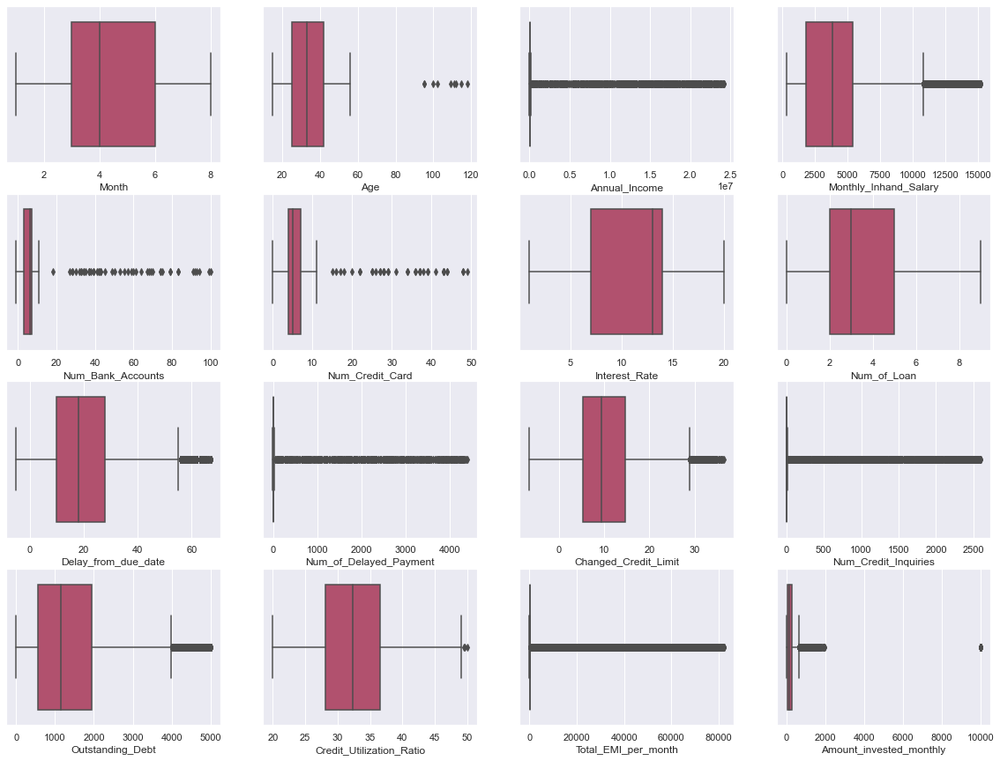

In [104]:
box_plot(train,num_cols)

In [105]:
df_num_clean = train[num_cols].copy()

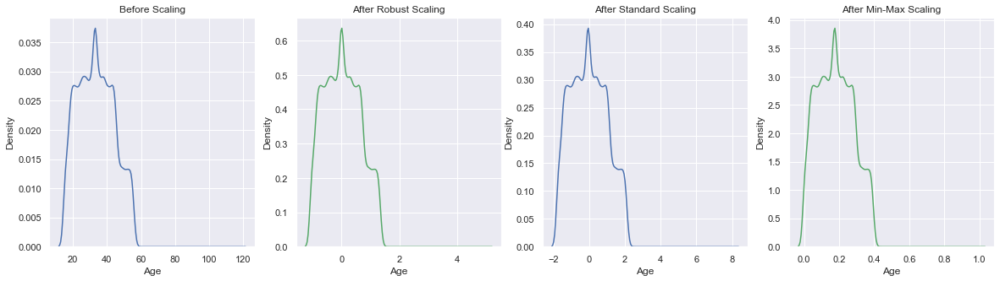

In [106]:
cols = num_cols
scaler = preprocessing.RobustScaler()
robust_df_ = scaler.fit_transform(df_num_clean)
robust_df_ = pd.DataFrame(robust_df_, columns =cols)
  
scaler = preprocessing.StandardScaler()
standard_df = scaler.fit_transform(df_num_clean)
standard_df = pd.DataFrame(standard_df, columns =cols)
  
scaler = preprocessing.MinMaxScaler()
minmax_df = scaler.fit_transform(df_num_clean)
minmax_df = pd.DataFrame(minmax_df, columns =cols)
  
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols = 4, figsize =(20, 5))
ax1.set_title('Before Scaling')
  
sns.kdeplot(df_num_clean['Age'], ax = ax1, color ='b')
ax2.set_title('After Robust Scaling')
  
sns.kdeplot(robust_df_['Age'], ax = ax2, color ='g')
ax3.set_title('After Standard Scaling')
  
sns.kdeplot(standard_df['Age'], ax = ax3, color ='b')
ax4.set_title('After Min-Max Scaling')
  
sns.kdeplot(minmax_df['Age'], ax = ax4, color ='g')
plt.show()